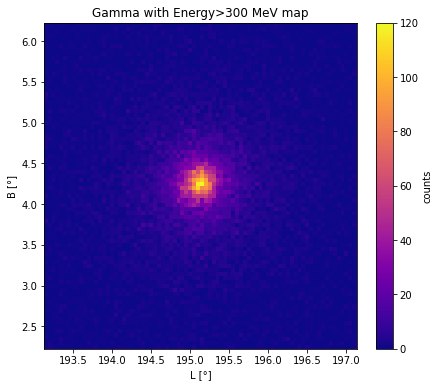

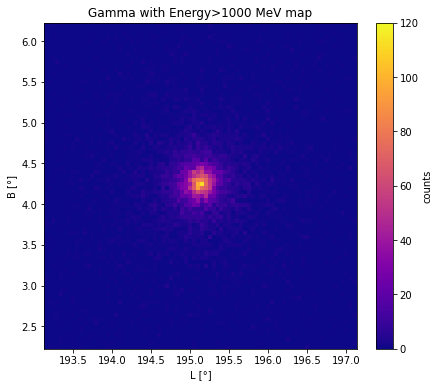

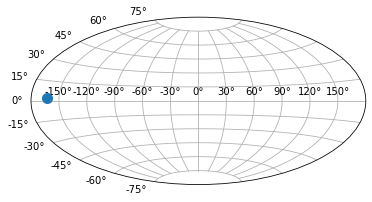

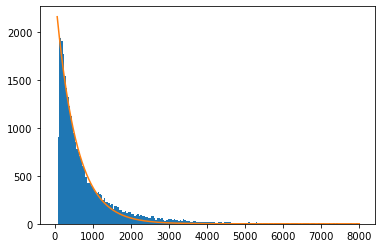

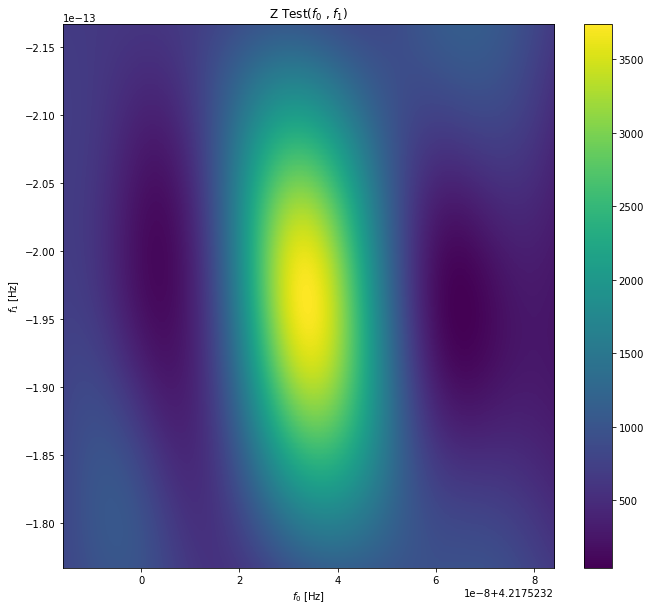

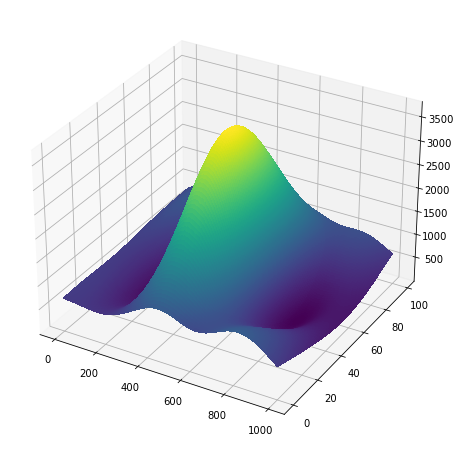

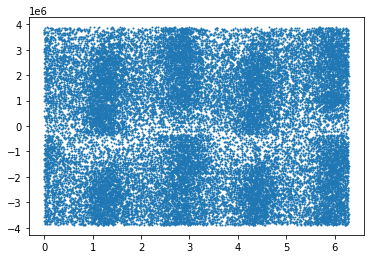

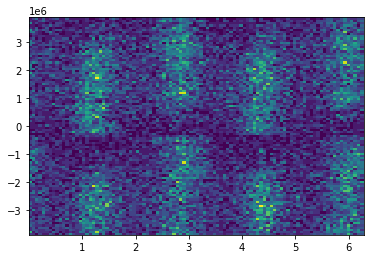

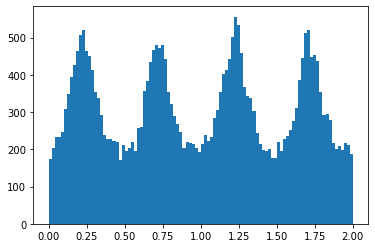

In [1]:
import os 
from astropy.io import fits
from astropy.table import Table
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit
#import ztest
from numba import jit

src_dir = os.getcwd()
main_dir = os.path.dirname(src_dir)
data_dir=os.path.join(main_dir, "data")
results_dir = os.path.join(main_dir, "results")

f0_start=4.2175
f1_start=-1.95250e-13
t0= 250992001

class Data():
    def __init__(self,fit_name):
        self.fit_file=fits.open(os.path.join(data_dir,fit_name))
        self.data=Table(self.fit_file[1].data)
        self.gti=Table(self.fit_file[2].data)
        self.data_header=self.fit_file[1].header
        self.gti_header=self.fit_file[2].header
        self.z_test=0
        self.z_test_max=0
        self.f0_best=0
        self.f1_best=0
        self.f0_arr=0
        self.f1_arr=0
        self.phase=0
        self.ph_time=np.array(self.data["TIME"])-t0
        self.load()
        
    def __repr__(self):
        return str(self.data)
    
    def __len__(self):
        return len(self.data)
    
    def mapping(self,energy,vmax=120):
        gamma_E=self.data[self.data["ENERGY"]>energy]
        plt.figure(figsize=(7,6))
        plt.subplot(111)
        xm=195.1317
        d=2
        x0=xm-d
        x1=xm+d
        ym=4.2252836
        y0=ym-d
        y1=ym+d
        plt.hist2d(gamma_E["L"],gamma_E["B"],cmap='plasma',vmax=vmax,bins=(80,80),range=[[x0,x1],[y0,y1]])
        plt.colorbar(label='counts')
        plt.xlabel("L [°]")
        plt.ylabel("B [°]")
        #plt.xlim(194.1317,196.1317)
        #plt.ylim(3.4252836,5.0252836)
        plt.title(f"Gamma with Energy>{energy} MeV map")
        plt.show()
        
    def aitoff(self):
        plt.subplot(111,projection='aitoff')
        l=np.array([x if x<180 else x-360 for x in self.data[self.data["L"]>180]["L"]])*np.pi/180
        plt.plot(l[10],self.data["B"][10]*np.pi/180,".",markersize=20)
        plt.grid()
        plt.show()
        
    def energy_plot(self):
        plt.figure()
        #hist=plt.hist(self.data["ENERGY"],bins=200,range=(0,8000))
        hist=plt.hist(self.data["ENERGY"],bins=200,range=(0,8000))
        def exp(x,a,t):
            return a*np.exp(-x/t)
        popt,pcov=curve_fit(exp,hist[1][3:-1],hist[0][3:],p0=[2000,1000])
        x=np.linspace(60,8000,400)
        plt.plot(x,exp(x,*popt))
        #plt.plot(hist[1][3:-1],hist[0][3:],".")
        plt.show()
        return popt
    
        
    
    def load(self):
        self.z_test=np.load(os.path.join(data_dir,"z_test.npy"))
        self.f0_arr=np.load(os.path.join(data_dir,"f0_arr.npy"))
        self.f1_arr=np.load(os.path.join(data_dir,"f1_arr.npy"))
        self.phase=np.load(os.path.join(data_dir,"phase.npy"))
        f_best_index=np.unravel_index(np.argmax(self.z_test),self.z_test.shape)
        self.f0_best=self.f0_arr[f_best_index[1]]
        self.f1_best=self.f1_arr[f_best_index[0]]
        
        
    def save(self):
    
        np.save(os.path.join(data_dir,"z_test.npy"),self.z_test)
        np.save(os.path.join(data_dir,"f0_arr.npy"),self.f0_arr)
        np.save(os.path.join(data_dir,"f1_arr.npy"),self.f1_arr)
        np.save(os.path.join(data_dir,"phase.npy"),self.phase)

    ###DEPRECATED ZTEST WITH FORTRAN: GIVE ARITHMETIC ERRORS THAT MESS EVERYTHING
    """       
    def ztest(self, save=False,
                    f0_start=4.21786,
                    delta0=  0.00004,
                    n0=500,
                    #f1_start=-1.9525000000000000e-13,
                    f1_start=-1.951e-13,
                    delta1=5.00000e-16,
                    n1=100,
                    n_harm=10):   

            

        self.f0_arr=np.linspace(f0_start-delta0,f0_start+delta0,n0)
        self.f1_arr=np.linspace(f1_start-delta1,f1_start+delta1,n1)
        z_test=ztest.mod.matrix(self.ph_time,self.f0_arr,self.f1_arr,len(self.data),n_harm,len(self.f0_arr),len(self.f1_arr))
        self. z_test=(2/len(self.data))*z_test
        self.z_test_max=np.max(z_test)
        arg=np.argmax(z_test)
        f_best_index=np.unravel_index(arg,z_test.shape)
        self.f0_best=self.f0_arr[f_best_index[0]]
        self.f1_best=self.f1_arr[f_best_index[1]]
        self.phase=((self.f0_best*self.ph_time+(self.f1_best*np.power(self.ph_time,2))/2)%1)*2*np.pi
        
        if save==True:
            self.save()            
        
        
        return [self.f0_best,self.f1_best,self.z_test_max]
    """
    @jit
    def phase_func(self,f0,f1):
        return ((f0*self.ph_time+(f1*np.power(self.ph_time,2))/2)%1)*2*np.pi

    
    @jit   
    def ztest_func(self,phase,n_harm):
        k=np.arange(1,n_harm+1)
        k=np.reshape(k,(k.shape[0],1))
        return (2/len(self.data))*np.sum(np.power(np.sum(np.cos(phase*k),axis=1),2)+np.power(np.sum(np.sin(phase*k),axis=1),2))

        
    @jit    
    def ztest(self, save=False,
                    f0_start=4.21752323401995,
                    df0=     0.00000005,
                    n0=1000,                    
                    f1_start=-1.96678571365e-13,
                    df1=      2.0000e-14,
                    n1=100,
                    n_harm=10):
        self.f0_arr=np.linspace(f0_start-df0,f0_start+df0,n0)
        self.f1_arr=np.linspace(f1_start-df1,f1_start+df1,n1)
        self.z_test=np.array([[self.ztest_func(self.phase_func(f0,f1),n_harm) for f0 in self.f0_arr] for f1 in self.f1_arr])
        self.z_test_max=np.max(self.z_test)
        arg=np.argmax(self.z_test)
        f_best_index=np.unravel_index(arg,self.z_test.shape)
        self.f0_best=self.f0_arr[f_best_index[1]]
        self.f1_best=self.f1_arr[f_best_index[0]]
        self.phase=self.phase_func(self.f0_best,self.f1_best)
        if save==True:
            save()
        
    
    """  def pippo(self,f0_arr,f1_arr):
        
        self.z_test=self.ztest(((self.phase(f0,f1) for f0 in f0_arr) for f1 in f1_arr))
        return
        """
    
    def ztest_map(self):
        plt.figure(figsize=(11,10))
        #ATTENZIONE AGLI ASSI FORSE SBAGLIATI
        plt.imshow(self.z_test,aspect='auto',extent=[self.f0_arr[0],self.f0_arr[-1],self.f1_arr[-1],self.f1_arr[0]])
        #plt.imshow(self.z_test,aspect='auto')
        plt.colorbar()
        plt.xlabel("$f_0$ [Hz]")
        plt.ylabel("$f_1$ [Hz]")
        plt.title("Z Test($f_0$ , $f_1$)")
        h, w = (self.z_test).shape
        plt.figure(figsize=(16, 8))
        ax = plt.axes(projection='3d')
        X, Y = np.meshgrid(np.arange(w), np.arange(h))
        ax.plot_surface(X, Y, self.z_test, rstride=1, cstride=1, cmap='viridis', edgecolor='none', antialiased=False)
                
        plt.show()

    def scatter_phase(self):
        plt.plot(self.phase,self.ph_time,".",markersize=2)
        plt.figure()
        plt.hist2d(self.phase,self.ph_time,bins=(100,100))
        plt.show()
        
    def light_curve(self,e_min=0,e_max=500000,bins=100,offset=0):
        ph=self.phase[(self.data["ENERGY"]>e_min) & (self.data["ENERGY"]<e_max)]
        ph=((ph+offset)%(2*np.pi))
        plt.hist(ph/np.pi,bins)
        plt.show()
        


tt=Data("PSRJ_Geminga_3deg_100mev_tt.fits")
bary=Data("PSRJ_Geminga_3deg_100mev_bary.fits")




tt.mapping(300)
tt.mapping(1000)
tt.aitoff()
popt=tt.energy_plot()



#bary.ztest()
bary.ztest_map()

bary.scatter_phase()
bary.light_curve(offset=1)

